# Import the libraries

In [3]:
# Essential libraries: 
import pandas as pd
import numpy as np

# visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.offline as py
from plotly import tools
py.init_notebook_mode(connected=True)
import plotly.io as pio
pio.templates.default = "plotly_white"
from plotly.subplots import make_subplots

# import folium
%matplotlib inline

# hide warnings
import warnings
warnings.filterwarnings('ignore')

# Import the dataset

In [7]:
cleaned_data = pd.read_csv('covid_19_clean_complete.csv')
cleaned_data.head ()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.0000,65.0000,1/22/20,0,0,0
1,NaN,Albania,41.1533,20.1683,1/22/20,0,0,0
2,NaN,Algeria,28.0339,1.6596,1/22/20,0,0,0
3,NaN,Andorra,42.5063,1.5218,1/22/20,0,0,0
4,NaN,Angola,-11.2027,17.8739,1/22/20,0,0,0


# Data Cleaning

In [8]:
def show_null(cleaned_data):
    null_columns = (cleaned_data.isnull().sum(axis = 0)/len(cleaned_data)).sort_values(ascending=False).index
    null_df = pd.concat([cleaned_data.isnull().sum(axis = 0),
                           (cleaned_data.isnull().sum(axis = 0)/len(cleaned_data)).sort_values(ascending=False)*100,
                           cleaned_data.loc[:, cleaned_data.columns.isin(list(null_columns))].dtypes]
                          , axis=1, sort= 'True')
    null_df = null_df.rename(columns={0: 'Null data amount', 
                                          1: 'Missing data (%)', 
                                          2: 'type'}).sort_values(ascending=False, by = 'Missing data (%)')
    null_df = null_df[null_df["Null data amount"]!=0]
    return null_df

df_perc = show_null(cleaned_data)
df_perc

,Null data amount,Missing data (%),type
Province/State,13937,69.348659,object


Index(['Province/State', 'Recovered', 'Deaths', 'Confirmed', 'Date', 'Long',
       'Lat'],
      dtype='object')


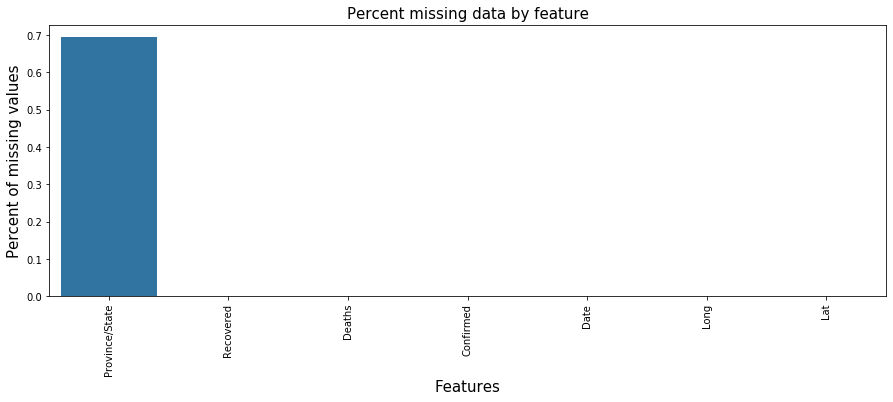

In [9]:
total = cleaned_data.isnull().sum().sort_values(ascending=False)
percent = (cleaned_data.isnull().sum()/cleaned_data.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent']).head(7)

f, ax = plt.subplots(figsize=(15, 5))
plt.xticks(rotation='90')
sns.barplot(x=missing_data.index, y=missing_data['Percent'])
plt.xlabel('Features', fontsize=15)
plt.ylabel('Percent of missing values', fontsize=15)
plt.title('Percent missing data by feature', fontsize=15)

print(missing_data.index)

In [10]:
cleaned_data.rename(columns={'ObservationDate': 'date', 
                     'Province/State':'state',
                     'Country/Region':'country',
                     'Last Update':'last_updated',
                     'Confirmed': 'confirmed',
                     'Deaths':'deaths',
                     'Recovered':'recovered'
                    }, inplace=True)

# cases 
cases = ['confirmed', 'deaths', 'recovered', 'active']

# Active Case = confirmed - deaths - recovered
cleaned_data['active'] = cleaned_data['confirmed'] - cleaned_data['deaths'] - cleaned_data['recovered']

# replacing Mainland china with just China
cleaned_data['country'] = cleaned_data['country'].replace('Mainland China', 'China')

# filling missing values 
cleaned_data[['state']] = cleaned_data[['state']].fillna('')
cleaned_data[cases] = cleaned_data[cases].fillna(0)
cleaned_data.rename(columns={'Date':'date'}, inplace=True)

data = cleaned_data

In [11]:
data.head()

,state,country,Lat,Long,date,confirmed,deaths,recovered,active
0,,Afghanistan,33.0000,65.0000,1/22/20,0,0,0,0
1,,Albania,41.1533,20.1683,1/22/20,0,0,0,0
2,,Algeria,28.0339,1.6596,1/22/20,0,0,0,0
3,,Andorra,42.5063,1.5218,1/22/20,0,0,0,0
4,,Angola,-11.2027,17.8739,1/22/20,0,0,0,0


In [12]:
print("External Data")
print(f"Earliest Entry: {data['date'].min()}")
print(f"Last Entry:     {data['date'].max()}")

External Data
Earliest Entry: 1/22/20
Last Entry:     4/7/20


# Exploratory Data Analysis

## 1. General Information of COV-19

In [49]:
general = data.groupby(['country'])['confirmed', 'deaths', 'recovered', 'active'].max()

In [50]:
general.head()

,confirmed,deaths,recovered,active
country,,,,
Afghanistan,423,14,18,391
Albania,383,22,131,240
Algeria,1468,193,113,1162
Andorra,545,22,39,484
Angola,17,2,2,13


In [51]:
general.info()

<class 'pandas.core.frame.DataFrame'>
Index: 184 entries, Afghanistan to Zimbabwe
Data columns (total 4 columns):
confirmed    184 non-null int64
deaths       184 non-null int64
recovered    184 non-null int64
active       184 non-null int64
dtypes: int64(4)
memory usage: 7.2+ KB


In [52]:
# M'agradaria posar el percentatge!!! 
# color pallette
cnf = '#f08080' # confirmed - grey
dth = '#f9246e' # death - red
rec = '#9f043a' # recovered - cyan
act = '#fdb4ce' # active case - yellow

tm = general.melt(id_vars="date", value_vars=['active', 'deaths', 'recovered','confirmed'])
fig = px.treemap(tm, path=["variable"], values="value", height=400, width=600,
                 color_discrete_sequence=[rec, act, dth, cnf])
fig.show()

In [53]:
# Corretjeixo el datetime
data["date"]=pd.to_datetime(data["date"])

In [14]:
# Convert date column to appropriate data type
data['date'] = pd.to_datetime(data['date'])

In [55]:
#Grouping different types of cases as per the date
datewise=data.groupby(["date"]).agg({"confirmed":'sum',"recovered":'sum',"deaths":'sum', "active":'sum'})
datewise.head()

,confirmed,recovered,deaths,active
date,,,,
2020-01-22,555,28,17,510
2020-01-23,654,30,18,606
2020-01-24,941,36,26,879
2020-01-25,1434,39,42,1353
2020-01-26,2118,52,56,2010


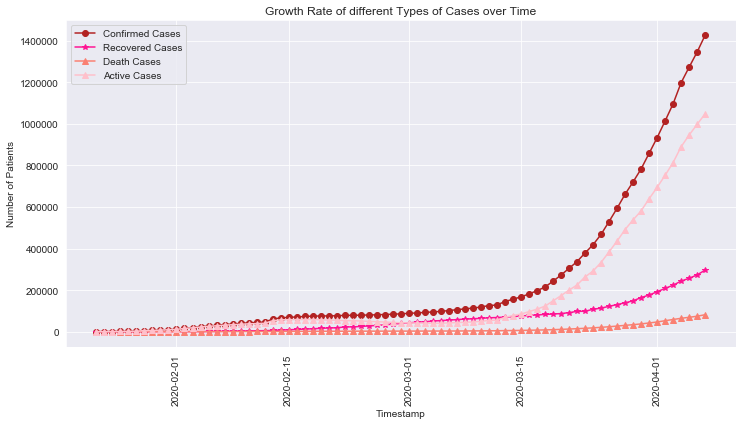

In [56]:
plt.figure(figsize=(12,6))
plt.plot(datewise["confirmed"],marker="o",label="Confirmed Cases", color='firebrick')
plt.plot(datewise["recovered"],marker="*",label="Recovered Cases", color='deeppink') 
plt.plot(datewise["deaths"],marker="^",label="Death Cases", color='salmon')
plt.plot(datewise["active"],marker="^",label="Active Cases", color='pink')
plt.ylabel("Number of Patients")
plt.xlabel("Timestamp")
plt.xticks(rotation=90)
plt.title("Growth Rate of different Types of Cases over Time")
plt.legend()

## 2.  Check how the virus is spread out across the globe

### 2.a. Confirmed cases

**Confirmed cases per country along time (Bar Chart)**

This is how the spread of the virus has spread over time across the globe

In [57]:
copy2 = data.copy()
copy2 = copy2[copy2['date']==max(copy2['date'])].reset_index(drop=True)
top15_df = copy2.groupby(['country'])['confirmed','recovered','deaths'].sum().sort_values(by='confirmed',ascending=False).head(15)
top15_countries = top15_df.index.values

# Aggregate at country, date level and filter data for top 15 countries only
copy2 = data.groupby(['country','date'])['confirmed','recovered','deaths','active'].sum().reset_index()
is_top15 = copy2['country'].isin(top15_countries)
copy2 = copy2[is_top15]

# Convert date to correct format
copy2["date"] = pd.to_datetime(copy2["date"] , format="%m/%d/%Y").dt.date
copy2.sort_values(by="date").reset_index(drop=True)
copy2["date"] = copy2["date"].astype(str)

In [58]:
fig3 = go.Figure()
fig3 = px.bar(copy2,
                x="country",
                y="confirmed",
                color="country",
                animation_frame="date",
                animation_group="country",
                title="Time Lapse of CoVid-19 Confirmed Cases")
fig3.show()

In [59]:
py.offline.plot(fig3, filename='myplot.html')

'myplot.html'

In [60]:
# Cases in Most European countries have rapidly increased.

**Confirmed cases per country (Map)**

This is how the situation looks right now: 

In [61]:
temp = cleaned_data[[col for col in cleaned_data.columns if col != 'state']]

latest = temp[temp['date'] == max(temp['date'])].reset_index()
latest_grouped = latest.groupby('country')['confirmed', 'deaths', 'active', 'recovered'].sum().reset_index()

In [62]:
latest_grouped.head()

,country,confirmed,deaths,active,recovered
0,Afghanistan,423,14,391,18
1,Albania,383,22,230,131
2,Algeria,1468,193,1162,113
3,Andorra,545,22,484,39
4,Angola,17,2,13,2


In [63]:
latest_grouped.columns

Index(['country', 'confirmed', 'deaths', 'active', 'recovered'], dtype='object')

In [64]:
latest_grouped[latest_grouped.country=='Spain']

,country,confirmed,deaths,active,recovered
156,Spain,141942,14045,84689,43208


In [65]:
fig = px.choropleth(latest_grouped, locations="country", 
                    locationmode='country names', color="confirmed", 
                    hover_name="country", range_color=[1,100000], 
                    color_continuous_scale="Burg", 
                    title='Countries with Confirmed Cases')
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [66]:
x=data.groupby(['country'],as_index=False)['confirmed'].last().sort_values(by="confirmed",ascending=False)
fig=px.pie(x,"country","confirmed", color_discrete_sequence=px.colors.sequential.Burg)
fig.update_layout(title="Global Covid-19 Confirmed")

In [67]:
fig = px.bar(latest_grouped.sort_values('confirmed', ascending=False)[:10][::-1], 
             x='confirmed', y='country', color_discrete_sequence=['#f08080'],
             title='Confirmed Cases in Europe', text='confirmed', orientation='h')
fig.show()

**Zoom in Europe (Map)**

In [68]:
europe = list(['Austria','Belgium','Bulgaria','Croatia','Cyprus','Czechia','Denmark','Estonia','Finland','France','Germany','Greece','Hungary','Ireland',
               'Italy', 'Latvia','Luxembourg','Lithuania','Malta','Norway','Netherlands','Poland','Portugal','Romania','Slovakia','Slovenia',
               'Spain', 'Sweden', 'United Kingdom', 'Iceland', 'Russia', 'Switzerland', 'Serbia', 'Ukraine', 'Belarus',
               'Albania', 'Bosnia and Herzegovina', 'Kosovo', 'Moldova', 'Montenegro', 'North Macedonia'])

europe_grouped_latest = latest_grouped[latest_grouped['country'].isin(europe)]

In [69]:
fig = px.choropleth(europe_grouped_latest, locations="country", 
                    locationmode='country names', color="confirmed", 
                    hover_name="country", range_color=[1,100000], 
                    color_continuous_scale='Burg', 
                    title='European Countries with Confirmed Cases', scope='europe', height=800)
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [70]:
# Looks like the COVID-19 has the strongest of holds in Western Europe right now.

In [71]:
fig = px.bar(europe_grouped_latest.sort_values('confirmed', ascending=False)[:41][::-1], 
             x='confirmed', y='country', color_discrete_sequence=['#f08080'],
             title='Confirmed Cases in Europe', text='confirmed', orientation='h')
fig.show()

### 2.b. Death Cases

In [72]:
fig = px.choropleth(latest_grouped, locations="country", 
                    locationmode='country names', color="deaths", 
                    hover_name="country", range_color=[1,10000], 
                    color_continuous_scale="Burg", 
                    title='Countries with Deaths Cases')
# fig.update(layout_coloraxis_showscale=False)
fig.show()

In [73]:
x=europe_grouped_latest.groupby(['country'],as_index=False)['deaths'].last().sort_values(by="deaths",ascending=False)
fig=px.pie(x,"country","deaths", color_discrete_sequence=px.colors.sequential.Burg)
fig.update_layout(title="Global Covid-19 Deaths")


In [74]:
import datetime

cumulative_df = data.groupby(["country", "date"])["confirmed", "deaths", "recovered"].sum().reset_index()
cumulative_df["date"] = pd.to_datetime(cumulative_df["date"] , format="%m/%d/%Y").dt.date
cumulative_df = data.sort_values(by="date").reset_index(drop=True)
start_date = datetime.date(2020, 1, 22) 
cumulative_df = cumulative_df[cumulative_df["date"]>=start_date]
cumulative_df["date"] = cumulative_df["date"].astype(str)
cumulative_df.head()

,state,country,Lat,Long,date,confirmed,deaths,recovered,active
0,,Afghanistan,33.0000,65.0000,2020-01-22,0,0,0,0
1,Aruba,Netherlands,12.5186,-70.0358,2020-01-22,0,0,0,0
2,Curacao,Netherlands,12.1696,-68.9900,2020-01-22,0,0,0,0
3,Sint Maarten,Netherlands,18.0425,-63.0548,2020-01-22,0,0,0,0
4,,Netherlands,52.1326,5.2913,2020-01-22,0,0,0,0


In [75]:
cumulative_df = data.groupby(["country", "date"])["confirmed", "deaths", "recovered"].sum().reset_index()
cumulative_df["date"] = pd.to_datetime(cumulative_df["date"] , format="%m/%d/%Y").dt.date
cumulative_df = cumulative_df.sort_values(by="date").reset_index(drop=True)
start_date = datetime.date(2020, 3, 10)
cumulative_df = cumulative_df[cumulative_df["date"]>=start_date]
cumulative_df["date"] = cumulative_df["date"].astype(str)

fig = px.scatter(cumulative_df, x="confirmed", y="deaths", animation_frame="date", animation_group="country",
           size="confirmed", color="country", hover_name="country",
           log_x=False, size_max=55, range_x=[0,470000], range_y=[-20,19000])

layout = go.Layout(
    title=go.layout.Title(
        text="Changes in number of confirmed & death cases over time in the different countries",
        x=0.5
    ),
    font=dict(size=14),
    xaxis_title = "Total number of confirmed cases",
    yaxis_title = "Total number of death cases"
)

fig.update_layout(layout)

fig.show()

In [76]:
py.offline.plot(fig, filename='myplot2.html')

'myplot2.html'

In [77]:
# Sense China
cumulative_df = data.groupby(["country", "date"])["confirmed", "deaths", "recovered"].sum().reset_index()
cumulative_df["date"] = pd.to_datetime(cumulative_df["date"] , format="%m/%d/%Y").dt.date
cumulative_df = cumulative_df.sort_values(by="date").reset_index(drop=True)
start_date = datetime.date(2020, 3, 10)
cumulative_df = cumulative_df[cumulative_df["date"]>=start_date]
cumulative_df["date"] = cumulative_df["date"].astype(str)

fig = px.scatter(cumulative_df, x="confirmed", y="deaths", animation_frame="date", animation_group="country",
           size="confirmed", color="country", hover_name="country",
           log_x=False, size_max=55, range_x=[0,45000], range_y=[-20,3500])

layout = go.Layout(
    title=go.layout.Title(
        text="Changes in number of confirmed & death cases over time in the different countries (without China)",
        x=0.5
    ),
    font=dict(size=14),
    xaxis_title = "Total number of confirmed cases",
    yaxis_title = "Total number of death cases"
)

fig.update_layout(layout)

fig.show()

### 2.c  Mortality and Recovery rate

In [78]:
#Calculating countrywise Moratality and Recovery Rate
countrywise=data[data["date"]==data["date"].max()].groupby(["country"]).agg({"confirmed":'sum',"recovered":'sum',"deaths":'sum'}).sort_values(["confirmed"],ascending=False)
countrywise["mortality"]=(countrywise["deaths"]/countrywise["confirmed"])*100
countrywise["recovery"]=(countrywise["recovered"]/countrywise["confirmed"])*100

Text(0.5, 0, 'Recovery (in Percentage)')

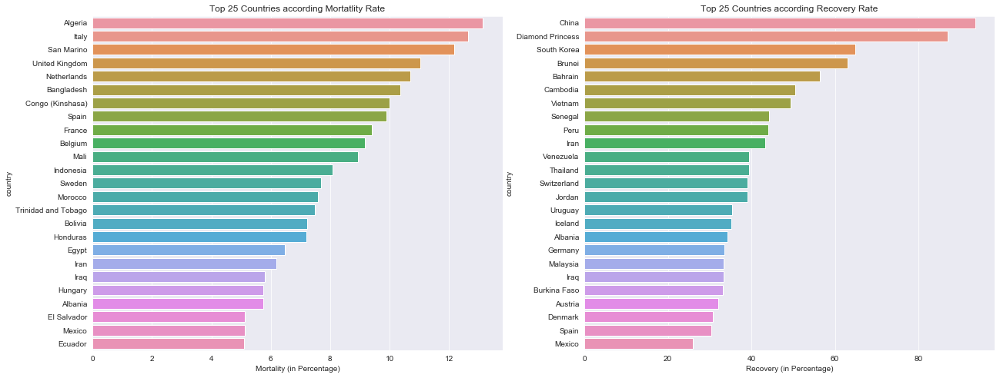

In [79]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(21,8))
countrywise_plot_mortal=countrywise[countrywise["confirmed"]>50].sort_values(["mortality"],ascending=False).head(25)
sns.barplot(x=countrywise_plot_mortal["mortality"],y=countrywise_plot_mortal.index,ax=ax1, )
ax1.set_title("Top 25 Countries according Mortatlity Rate")
ax1.set_xlabel("Mortality (in Percentage)")
countrywise_plot_recover=countrywise[countrywise["confirmed"]>100].sort_values(["recovery"],ascending=False).head(25)
sns.barplot(x=countrywise_plot_recover["recovery"],y=countrywise_plot_recover.index, ax=ax2)
ax2.set_title("Top 25 Countries according Recovery Rate")
ax2.set_xlabel("Recovery (in Percentage)")

In [80]:
formated_gdf = data.groupby(['date', 'country'])['confirmed', 'deaths'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['date'] = pd.to_datetime(formated_gdf['date'])
formated_gdf['date'] = formated_gdf['date'].dt.strftime('%m/%d/%Y')
formated_gdf['mortalityRate'] = round((formated_gdf['deaths']/formated_gdf['confirmed'])*100, 2)

fig = px.scatter_geo(formated_gdf.fillna(0), locations="country", locationmode='country names', 
                     color="mortalityRate", size='mortalityRate', hover_name="country", 
                     range_color= [0, 10], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Mortality Rate in % by country', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

### 1.d. Normalized by country population size.

In [81]:
def p2f(x):
    """
    Convert urban percentage to float
    """
    try:
        return float(x.strip('%'))/100
    except:
        return np.nan

def age2int(x):
    """
    Convert Age to integer
    """
    try:
        return int(x)
    except:
        return np.nan

def fert2float(x):
    """
    Convert Fertility Rate to float
    """
    try:
        return float(x)
    except:
        return np.nan

population_data = pd.read_csv('population_by_country_2020.csv' , converters={'Urban Pop %':p2f,
                                                                                                             'Fert. Rate':fert2float,
                                                                                                             'Med. Age':age2int})

population_data.rename(columns={'Country (or dependency)': 'country',
                             'Population (2020)' : 'population',
                             'Density (P/Km²)' : 'density',
                             'Fert. Rate' : 'fertility',
                             'Med. Age' : "age",
                             'Urban Pop %' : 'urban_percentage'}, inplace=True)



population_data['country'] = population_data['country'].replace('United States', 'US')
population_data = population_data[["country", "population", "density", "fertility", "age", "urban_percentage"]]

population_data.head()

,country,population,density,fertility,age,urban_percentage
0,China,1439323776,153,1.7,38.0,0.61
1,India,1380004385,464,2.2,28.0,0.35
2,US,331002651,36,1.8,38.0,0.83
3,Indonesia,273523615,151,2.3,30.0,0.56
4,Pakistan,220892340,287,3.6,23.0,0.35


In [82]:
data_all = pd.merge(data, population_data, on='country')
data_all.head()

,state,country,Lat,Long,date,confirmed,deaths,recovered,active,population,density,fertility,age,urban_percentage
0,,Afghanistan,33.0,65.0,2020-01-22,0,0,0,0,38928346,60,4.6,18.0,0.25
1,,Afghanistan,33.0,65.0,2020-01-23,0,0,0,0,38928346,60,4.6,18.0,0.25
2,,Afghanistan,33.0,65.0,2020-01-24,0,0,0,0,38928346,60,4.6,18.0,0.25
3,,Afghanistan,33.0,65.0,2020-01-25,0,0,0,0,38928346,60,4.6,18.0,0.25
4,,Afghanistan,33.0,65.0,2020-01-26,0,0,0,0,38928346,60,4.6,18.0,0.25


In [16]:
cleaned_latest = data_all[data_all['date'] == max(data_all['date'])]
flg = cleaned_latest.groupby('country')['confirmed', 'population'].agg({'confirmed':'sum', 'population':'mean'}).reset_index()

flg['infectionRate'] = round((flg['confirmed']/flg['population'])*100, 5)
temp = flg[flg['confirmed']>100]
temp = temp.sort_values('infectionRate', ascending=False)

fig = px.bar(temp.sort_values(by="infectionRate", ascending=False)[:10][::-1],
             x = 'infectionRate', y = 'country', 
             title='% of infected people by country', text='infectionRate', height=800, orientation='h',
             color_discrete_sequence=['#f08080']
            )
fig.show()

In [17]:
formated_gdf = data_all.groupby(['date', 'country'])['confirmed', 'population'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['date'] = pd.to_datetime(formated_gdf['date'])
formated_gdf['date'] = formated_gdf['date'].dt.strftime('%m/%d/%Y')
formated_gdf['infectionRate'] = round((formated_gdf['confirmed']/formated_gdf['population'])*100, 8)

fig = px.scatter_geo(formated_gdf, locations="country", locationmode='country names', 
                     color="infectionRate", size='infectionRate', hover_name="country", 
                     range_color= [0, 0.2], 
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Spread Over Time (Normalized by Country Population)', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()